In [1]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


In [2]:
import string
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import *
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import os
import matplotlib.pyplot as plt

In [3]:
df = pd.read_csv("C:/Users/shahk/OneDrive/Desktop/Dataset/Datafiniti_Fast_Food_Restaurants_May19.csv")

In [4]:
df

,id,dateAdded,dateUpdated,address,categories,primaryCategories,city,country,keys,latitude,longitude,name,postalCode,province,sourceURLs,websites
0,AWrSh_KgsVYjT2BJAzaH,2019-05-19T23:58:05Z,2019-05-19T23:58:05Z,2555 11th Avenue,"Fast Food Restaurants,Hamburgers and Hot Dogs,...",Accommodation & Food Services,Greeley,US,us/co/greeley/255511thavenue/554191587,40.396290,-104.696990,Carl's Jr.,80631,CO,https://www.yellowpages.com/greeley-co/mip/car...,https://www.carlsjr.com/?utm_source=Yextandutm...
1,AWEKlA-LIxWefVJwxG9B,2018-01-18T18:30:23Z,2019-05-19T23:45:05Z,2513 Highway 6 And 50,"Restaurant,Mexican Restaurants,Fast Food Resta...",Accommodation & Food Services,Grand Junction,US,us/co/grandjunction/2513highway6and50/1550891556,39.081350,-108.586890,Del Taco,81505,CO,http://www.citysearch.com/profile/772076870/gr...,http://www.deltaco.com
2,AWrSfAcYsVYjT2BJAzPt,2019-05-19T23:45:04Z,2019-05-19T23:45:04Z,1125 Patterson Road,"Sandwich Shops,Fast Food Restaurants,Restauran...",Accommodation & Food Services,Grand Junction,US,us/co/grandjunction/1125pattersonroad/-2137447852,39.091480,-108.554110,Which Wich,81506,CO,https://www.yellowpages.com/grand-junction-co/...,http://www.whichwich.com
3,AWrSa3NAQTFama1Xpkbz,2019-05-19T23:26:58Z,2019-05-19T23:26:58Z,3455 N Salida Court,"Fast Food Restaurants,Mexican Restaurants,Rest...",Accommodation & Food Services,Aurora,US,us/co/aurora/3455nsalidacourt/1143321601,39.763690,-104.776710,Chipotle Mexican Grill,80011,CO,https://www.yellowpages.com/aurora-co/mip/chip...,http://www.chipotle.com
4,AWrSaVGzZ4Yw-wtdgcaB,2019-05-19T23:24:38Z,2019-05-19T23:24:38Z,5225 E Colfax Avenue,"Fast Food Restaurants,Mexican Restaurants,Rest...",Accommodation & Food Services,Denver,US,us/co/denver/5225ecolfaxavenue/-864103396,39.740440,-104.926360,Taco Bell,80220,CO,https://www.yellowpages.com/denver-co/mip/taco...,https://locations.tacobell.com/co/denver/5225-...
5,AWrSaQ5RZ4Yw-wtdgcZw,2019-05-19T23:24:21Z,2019-05-19T23:24:21Z,1350 W Colfax Avenue,"Fast Food Restaurants,Hamburgers and Hot Dogs,...",Accommodation & Food Services,Denver,US,us/co/denver/1350wcolfaxavenue/-1161002137,39.739670,-105.004670,McDonald's,80204,CO,https://www.yellowpages.com/denver-co/mip/mcdo...,https://www.mcdonalds.com/us/en-us/location/CO...
6,AWrSaQ4EsVYjT2BJAy_I,2019-05-19T23:24:21Z,2019-05-19T23:24:21Z,200 16th Street,"Fast Food Restaurants,Hamburgers and Hot Dogs,...",Accommodation & Food Services,Denver,US,us/co/denver/20016thstreet/-1161002137,39.741700,-104.988290,McDonald's,80202,CO,https://www.yellowpages.com/denver-co/mip/mcdo...,https://www.mcdonalds.com/us/en-us/location/CO...
7,AWCvDUHSIxWefVJwvq4y,2018-01-01T00:01:02Z,2019-05-19T22:58:35Z,1772 N College Ave,"Restaurant,Carry-out food,Mexican Restaurants,...",Accommodation & Food Services,Fayetteville,US,us/ar/fayetteville/1772ncollegeave/-864103396,36.085369,-94.155319,Taco Bell,72703,AR,http://www.insiderpages.com/b/3709775090/taco-...,"http://www.tacobell.com/,http://www.tacobell.com"
8,AWrSTT3sQTFama1Xpjyq,2019-05-19T22:53:58Z,2019-05-19T22:53:58Z,605 S Havana Street,"Fast Food Restaurants,American Restaurants,Fam...",Accommodation & Food Services,Aurora,US,us/co/aurora/605shavanastreet/1077717834,39.705340,-104.866330,Captain D's Seafood Kitchen,80012,CO,https://www.yellowpages.com/denver-co/mip/capt...,http://www.captainds.com
9,AWkq412CIxWefVJwH_cO,2019-02-26T17:18:51Z,2019-05-19T22:51:18Z,16th Glenarm Place,"Mexican Restaurants,Caterers,Greek Restaurants...",Accommodation & Food Services,Denver,US,us/co/denver/16thglenarmplace/2067027233,39.749107,-104.994590,Shondiz,80202,CO,https://www.yellowpages.com/denver-co/mip/shon...,"http://www.shondiz.com,http://www.shondiz.com/"


In [5]:
df.shape

(10000, 16)

In [6]:
df.isna()

,id,dateAdded,dateUpdated,address,categories,primaryCategories,city,country,keys,latitude,longitude,name,postalCode,province,sourceURLs,websites
0,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
5,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
6,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
7,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
8,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False
9,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False


In [7]:
# the id, keys, sourceURLs, and websites are unique identifier
# we don't need them in our visualizations
df = df.drop(['id', 'keys', 'sourceURLs', 'websites'], axis=1)

# shape of dataset
print("Dimension after dropping columns:")
print(df.shape)

# take a peek at the head to verify the drop is successful
df.head()

Dimension after dropping columns:
(10000, 12)


,dateAdded,dateUpdated,address,categories,primaryCategories,city,country,latitude,longitude,name,postalCode,province
0,2019-05-19T23:58:05Z,2019-05-19T23:58:05Z,2555 11th Avenue,"Fast Food Restaurants,Hamburgers and Hot Dogs,...",Accommodation & Food Services,Greeley,US,40.39629,-104.69699,Carl's Jr.,80631,CO
1,2018-01-18T18:30:23Z,2019-05-19T23:45:05Z,2513 Highway 6 And 50,"Restaurant,Mexican Restaurants,Fast Food Resta...",Accommodation & Food Services,Grand Junction,US,39.08135,-108.58689,Del Taco,81505,CO
2,2019-05-19T23:45:04Z,2019-05-19T23:45:04Z,1125 Patterson Road,"Sandwich Shops,Fast Food Restaurants,Restauran...",Accommodation & Food Services,Grand Junction,US,39.09148,-108.55411,Which Wich,81506,CO
3,2019-05-19T23:26:58Z,2019-05-19T23:26:58Z,3455 N Salida Court,"Fast Food Restaurants,Mexican Restaurants,Rest...",Accommodation & Food Services,Aurora,US,39.76369,-104.77671,Chipotle Mexican Grill,80011,CO
4,2019-05-19T23:24:38Z,2019-05-19T23:24:38Z,5225 E Colfax Avenue,"Fast Food Restaurants,Mexican Restaurants,Rest...",Accommodation & Food Services,Denver,US,39.74044,-104.92636,Taco Bell,80220,CO


In [8]:
print("Number of unique restaurant:", df['name'].nunique())

Number of unique restaurant: 1545


Text(0, 0.5, 'count')

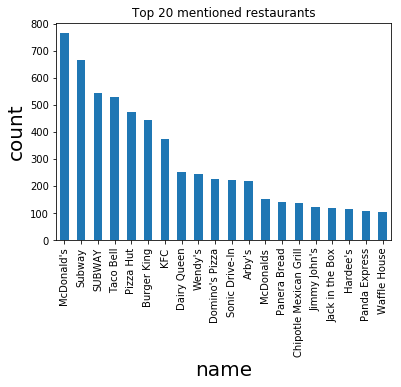

In [9]:
# top 20 restaurants recorded by count total
nameplot=df['name'].value_counts()[:20].plot.bar(title='Top 20 mentioned restaurants')
nameplot.set_xlabel('name',size=20)
nameplot.set_ylabel('count',size=20)

## NLP: More data cleaning is needed!!!

We can see there are "McDonald's" and "McDonalds" and "Subway" and "SUBWAY"

Let's apply NLTK's edit distance function to find the edit distance between those names
Edit Distance: The distance between the source string and the target string is the minimum number of edit operations (deletions, insertions, or substitutions) required to transform the source into the target. The lower the distance, the more similar the two strings

Due the reason of time-consuming, I commented out the code.

I copied and pasted the results to cells below

In [10]:
# # obtained unique names of restaurants
# restaurant_names = fastfood_data['name'].unique()

# # calculate similarity and record most-similar names together
# most_similar = []
# for i in range(len(restaurant_names)):
#     # temporary list to store the current similar words
#     temp_similar = [restaurant_names[i]]
    
#     # compare and save similar words
#     for j in range(len(restaurant_names)):
#         if restaurant_names[i] == restaurant_names[j]:
#             continue
#         if nltk.edit_distance(restaurant_names[i].lower(), restaurant_names[j].lower()) < 3:
#             temp_similar.append(restaurant_names[j])
            
#     # similar word(s) found
#     if len(temp_similar) > 1:
#         most_similar.append(temp_similar)
#     if i > 0 and i % 10 == 0:
#         print("index", i-10, "-", i, "checking finished| most similar size:", len(most_similar))
# print("similarity checking finished")

# # count number of similar words
# most_similar_word_count = 0
# for i in most_similar:
#     most_similar_word_count += len(i)
# print("size of the most similar list:", most_similar_word_count)
# most_similar

In [11]:
most_similar_edited = [["Carl's Jr.", "Carl's Jr", 'Carls Jr'],
 ["McDonald's", "Mc Donald's", 'Mcdonalds', 'McDonalds'],
 ['Cook-Out', 'Cook Out', 'CookOut'],
 ["Steak 'n Shake",
  "STEAK 'N SHAKE",
  'Steak N Shake',
  'Steak n Shake',
  "Steak 'N Shake"],
 ['QDOBA Mexican Eats', 'Qdoba Mexican Eats'],
 ['Burger King', 'Burger King®'],
 ["Hardee's", 'Hardees'],
 ['Taco Time', 'TacoTime'],
 ["Arby's", 'Arbys'],
 ['Chick-fil-A', 'Chick-Fil-A', 'ChickfilA'],
 ['Subway', 'SUBWAY'],
 ['Kfc', 'KFC'],
 ["Jack's", 'Jacks'],
 ['Sonic Drive-In',
  'SONIC Drive-In',
  'SONIC Drive In',
  'Sonic DriveIn',
  'Sonic Drive-in'],
 ["Church's Chicken", 'Churchs Chicken'],
 ['Big Boys', 'Big Boy'],
 ['Dairy Queen', 'Dairy queen'],
 ['Guthries', "Guthrie's"],
 ['Chick-Fil-A', 'Chick-fil-A', 'ChickfilA'],
 ["Wendy's", 'Wendys'],
 ["Jimmy John's", 'Jimmy Johns'],
 ['Dairy Queen Grill Chill', 'Dairy Queen Grill & Chill'],
 ["Moe's Southwest Grill", 'Moes Southwest Grill'],
 ["Domino's Pizza", 'Dominos Pizza'],
 ["Rally's", 'Rallys'],
 ['Full Moon Bar-B-Que', 'Full Moon Bar B Que'],
 ["Guthrie's", 'Guthries'],
 ["McAlister's Deli", "Mcalister's Deli", 'McAlisters Deli'],
 ["Jason's Deli", 'Jasons Deli'],
 ['KFC', 'Kfc', 'KFC Kentucky Fried Chicken', 'KFC - Kentucky Fried Chicken'],
 ['Popeyes Louisiana Kitchen', "Popeye's Louisiana Kitchen"],
 ["Long John Silver's", 'Long John Silvers'],
 ['BLIMPIE', 'Blimpie'],
 ['Five Guys Burgers Fries', 'Five Guys Burgers & Fries'],
 ['SUBWAY', 'Subway'],
 ['Dairy Queen Grill & Chill', 'Dairy Queen Grill Chill'],
 ['Potbelly Sandwich Works', 'Pot Belly Sandwich Works'],
 ["Charley's Grilled Subs", 'Charleys Grilled Subs'],
 ["Jersey Mike's Subs", 'Jersey Mikes Subs'],
 ['In-N-Out Burger', 'InNOut Burger'],
 ["Culver's", "CULVER'S", 'Culvers'],
 ["Famous Dave's", 'Famous Daves'],
 ["Freddy's Frozen Custard Steakburgers",
  'Freddys Frozen Custard Steakburgers',
  "Freddy's Frozen Custard & Steakburgers"],
 ['Cook Out', 'Cook-Out', 'CookOut'],
 ['TacoTime', 'Taco Time'],
 ['Hooters', 'Roosters'],
 ['BurgerFi', 'Burgerfi'],
 ["Chen's Restaurant", "Chan's Restaurant"],
 ['Taco Del Mar', 'Taco del Mar'],
 ['SONIC Drive-In',
  'Sonic Drive-In',
  'SONIC Drive In',
  'Sonic DriveIn',
  'Sonic Drive-in'],
 ['Ciscos Taqueria', "Cisco's Taqueria"],
 ['China King', 'China Lin'],
 ["Bojangles' Famous Chicken 'n Biscuits",
  'Bojangles Famous Chicken n Biscuits'],
 ["Dominic's of New York", 'Dominics of New York'],
 ["Papa John's Pizza", 'Papa Johns Pizza'],
 ['Chanellos Pizza', 'Chanello’s Pizza'],
 ["Fazoli's", 'Fazolis'],
 ['Wing Street', 'Wingstreet'],
 ["George's Gyros Spot", "George's Gyros Spot 2"],
 ['Taco Johns', "Taco John's"],
 ['RUNZA', 'Runza'],
 ['Bru Burger Bar', 'Grub Burger Bar'],
 ["Taco John's", 'Taco Johns'],
 ["Bob's Burger Brew", "Bob's Burgers Brew", "Bob's Burgers Brew", "Bob's Burger Brew"],
 ['Best Burgers', 'Best Burger'],
 ['Burgermaster', 'Burger Master'],
 ["Dick's Drive-In", "DK's Drive-In"],
 ["Charley's Grill Spirits", "Charley's Grill & Spirits"],
 ['Tom Drive-in', "Tom's Drive-In"],
 ["Fox's Pizza Den", 'Foxs Pizza Den'],
 ["Mc Donald's", "McDonald's", 'Mcdonalds', 'McDonalds'],
 ['Taco CASA', 'Taco Casa'],
 ["Mcalister's Deli", "McAlister's Deli", 'McAlisters Deli'],
 ['Saras Too', "Sara's Too"],
 ['Backyard Burgers', 'Back Yard Burgers'],
 ["CULVER'S", "Culver's", 'Culvers'],
 ["Simple Simon's Pizza", 'Simple Simons Pizza'],
 ['China Sea', 'China Star', 'China Bear'],
 ["Dino's Drive In", "Dan's Drive In"],
 ["STEAK 'N SHAKE",
  "Steak 'n Shake",
  'Steak N Shake',
  'Steak n Shake',
  "Steak 'N Shake"],
 ['Stanfields Steak House', "Stanfield's Steakhouse"],
 ['Wingstreet', 'Wing Street'],
 ["Big Billy's Burger Joint", 'Big Billys Burger Joint'],
 ['Big Boy', 'Big Boys'],
 ["Frisch's Big Boy Restaurant", "1 Frisch's Big Boy Restaurant", 
  "40 Frisch's Big Boy Restaurant", "1 Frisch's Big Boy Restaurant",
  "90 Frisch's Big Boy Restaurant"],
 ['Fireplace Restaurant Lounge', 'Fireplace Restaurant & Lounge'],
 ["Carl's Jr", "Carl's Jr.", 'Carls Jr'],
 ["Rick's on the River", 'Ricks on the River'],
 ['Grub Burger Bar', 'Bru Burger Bar'],
 ["Franky's", "Grandy's"],
 ['Gyro X-Press', 'Gyro Express'],
 ['Dominos Pizza', "Domino's Pizza"],
 ["Pietro's Pizza Gallery of Games", "Pietro's Pizza & Gallery of Games"],
 ['Burrtio Amigos', 'Burrito Amigos'],
 ["Albee's Ny Gyros", "Albee's NY Gyros"],
 ['Gyro Stop', 'Gyro Spot'],
 ['Nicholas Restaurant', "Nicholas' Restaurant"],
 ['Mcdonalds', "McDonald's", "Mc Donald's", 'McDonalds'],
 ['Burgerfi', 'BurgerFi'],
 ["Ryan's", 'Ryans'],
 ['Taste of Buffalo Pizzeria', 'Taste Of Buffalo Pizzeria'],
 ['Bad Daddys Burger Bar', "Bad Daddy's Burger Bar"],
 ["Zaxby's", "Arby's"],
 ["Topper's Pizza", 'Toppers Pizza'],
 ['C J Drive In', 'C & J Drive In'],
 ['Full Moon Bar B Que', 'Full Moon Bar-B-Que'],
 ['China Lin', 'China King'],
 ["Raising Cane's Chicken Fingers", 'Raising Canes Chicken Fingers'],
 ["Mary's Pizza Shack", 'Marys Pizza Shack'],
 ['Peking Chinese Restaurants', 'Peking Chinese Restaurant'],
 ['Arbys', "Arby's"],
 ['SONIC Drive In',
  'Sonic Drive-In',
  'SONIC Drive-In',
  'Sonic DriveIn',
  'Sonic Drive-in'],
 ['Hardees', "Hardee's"],
 ['McDonalds', "McDonald's", "Mc Donald's", 'Mcdonalds'],
 ['Wendys', "Wendy's"],
 ['Papa Johns Pizza', "Papa John's Pizza"],
 ["George's Gyros Spot 2", "George's Gyros Spot"],
 ['ChickfilA', 'Chick-fil-A', 'Chick-Fil-A'],
 ['Rallys', "Rally's"],
 ['C & J Drive In', 'C J Drive In'],
 ['Steak N Shake',
  "Steak 'n Shake",
  "STEAK 'N SHAKE",
  'Steak n Shake',
  "Steak 'N Shake"],
 ["Popeye's Louisiana Kitchen", 'Popeyes Louisiana Kitchen'],
 ["DJ's Drive-In", "DK's Drive-In"],
 ["Dan's Drive In", "Dino's Drive In"],
 ['Best Burger', 'Best Burgers', 'Beef Burger'],
 ['Jimmy Johns', "Jimmy John's"],
 ['BaskinRobbins', 'Baskin-Robbins', 'Baskin Robbins'],
 ['Carls Jr', "Carl's Jr.", "Carl's Jr"],
 ['WG Grinders', 'Wg Grinders'],
 ['McAlisters Deli', "McAlister's Deli", "Mcalister's Deli"],
 ['Fazolis', "Fazoli's"],
 ['Marys Pizza Shack', "Mary's Pizza Shack"],
 ['Bojangles Famous Chicken n Biscuits',
  "Bojangles' Famous Chicken 'n Biscuits"],
 ['Jacks', "Jack's"],
 ["Hardee's/red Burrito", 'Hardees Red Burrito', "Hardee's/Red Burrito"],
 ['Captain Ds', "Captain D'S"],
 ['Mr Hero', 'Mr. Hero'],
 ["Chan's Restaurant", "Chen's Restaurant"],
 ['Ritters Frozen Custard', "Ritter's Frozen Custard"],
 ['Hot Dog on a Stick', 'Hot Dog On A Stick'],
 ['Jersey Mikes Subs', "Jersey Mike's Subs"],
 ['AW Restaurants',
  'Aw Restaurants',
  'AWRestaurants',
  'A W Restaurant',
  'AW Restaurant',
  'Jam Restaurants'],
 ['Long John Silvers', "Long John Silver's"],
 ["Rally's Hamburgers", 'Rallys Hamburgers'],
 ['HomeTown Buffet', 'Hometown Buffet'],
 ['Back Yard Burgers', 'Backyard Burgers'],
 ['Hardees Red Burrito', "Hardee's/red Burrito", "Hardee's/Red Burrito"],
 ["DK's Drive-In", "Dick's Drive-In", "DJ's Drive-In", "K's Drive In"],
 ['Baskin-Robbins', 'BaskinRobbins', 'Baskin Robbins'],
 ['Churchs Chicken', "Church's Chicken"],
 ['Blimpie', 'BLIMPIE'],
 ['Foxs Pizza Den', "Fox's Pizza Den"],
 ['Steak n Shake',
  "Steak 'n Shake",
  "STEAK 'N SHAKE",
  'Steak N Shake',
  "Steak 'N Shake"],
 ['Rallys Hamburgers', "Rally's Hamburgers"],
 ['Sonic DriveIn',
  'Sonic Drive-In',
  'SONIC Drive-In',
  'SONIC Drive In',
  'Sonic Drive-in'],
 ['Famous Daves', "Famous Dave's"],
 ['Beef Burger', 'Best Burger'],
 ['Dominics of New York', "Dominic's of New York"],
 ['Z-Pizza', 'zpizza'],
 ['KFC - Kentucky Fried Chicken', 'KFC Kentucky Fried Chicken'],
 ["Rockne's", 'Rocknes'],
 ["Hardee's/Red Burrito", "Hardee's/red Burrito", 'Hardees Red Burrito'],
 ['Aw Restaurants',
  'AW Restaurants',
  'AWRestaurants',
  'A W Restaurant',
  'AW Restaurant',
  'Jam Restaurants'],
 ['AWRestaurants', 'AW Restaurants', 'Aw Restaurants', 'AW Restaurant'],
 ["Hardee's Restaurant", "Hardee's Restaurants"],
 ["Hardee's Restaurants", "Hardee's Restaurant"],
 ["Stanfield's Steakhouse", 'Stanfields Steak House'],
 ['Dunkin Donuts', "Dunkin' Donuts"],
 ['Einstein Bros. Bagels', 'Einstein Bros Bagels'],
 ['Simple Simons Pizza', "Simple Simon's Pizza"],
 ['A W Restaurant', 'AW Restaurants', 'Aw Restaurants', 'AW Restaurant'],
 ['Einstein Bros Bagels', 'Einstein Bros. Bagels'],
 ['Roosters', 'Hooters'],
 ['Culvers', "Culver's", "CULVER'S"],
 ['Slice of Life', 'Slice Of Life'],
 ['Jasons Deli', "Jason's Deli"],
 ['Wg Grinders', 'WG Grinders'],
 ['Charleys Grilled Subs', "Charley's Grilled Subs"],
 ['Freddys Frozen Custard Steakburgers',
  "Freddy's Frozen Custard Steakburgers"],
 ['Moes Southwest Grill', "Moe's Southwest Grill"],
 ['CookOut', 'Cook-Out', 'Cook Out'],
 ['Peking Chinese Restaurant', 'Peking Chinese Restaurants'],
 ['InNOut Burger', 'In-N-Out Burger'],
 ["Nicholas' Restaurant", 'Nicholas Restaurant'],
 ['Chanello’s Pizza', 'Chanellos Pizza'],
 ['Ryans', "Ryan's"],
 ['Burger King®', 'Burger King'],
 ['Toppers Pizza', "Topper's Pizza"],
 ["Albee's NY Gyros", "Albee's Ny Gyros"],
 ['Qdoba Mexican Eats', 'QDOBA Mexican Eats'],
 ['Runza', 'RUNZA'],
 ['Slice Of Life', 'Slice of Life'],
 ['Mai-Tai Restaurant', 'Mai Tai Restaurant'],
 ['Gyro Express', 'Gyro X-Press'],
 ['zpizza', 'Z-Pizza'],
 ['Raising Canes Chicken Fingers', "Raising Cane's Chicken Fingers"],
 ['Rocknes', "Rockne's"],
 ['LL Hawaiian Barbecue', 'L L Hawaiian Barbecue', 'L L Hawaiian Barbeque'],
 ['Dairy queen', 'Dairy Queen'],
 ['Blakes Lotaburger', "Blake's Lotaburger"],
 ['Emidio & Sons Italian Restaurant', 'Emidio Sons Italian Restaurant'],
 ['Taste Of Buffalo Pizzeria', 'Taste of Buffalo Pizzeria'],
 ['L L Hawaiian Barbecue',
  'LL Hawaiian Barbecue',
  'L L Hawaiian Barbeque',
  'L & L Hawaiian Barbecue'],
 ['Killer Burgers', 'Killer Burger'],
 ["Steak 'N Shake",
  "Steak 'n Shake",
  "STEAK 'N SHAKE",
  'Steak N Shake',
  'Steak n Shake'],
 ['Burrito Amigos', 'Burrtio Amigos'],
 ["Zack's Hamburgers", "Jack's Hamburgers"],
 ['AW Restaurant',
  'AW Restaurants',
  'Aw Restaurants',
  'AWRestaurants',
  'A W Restaurant'],
 ['Jam Restaurants', 'AW Restaurants', 'Aw Restaurants'],
 ['Big Billys Burger Joint', "Big Billy's Burger Joint"],
 ['L L Hawaiian Barbeque', 'LL Hawaiian Barbecue', 'L L Hawaiian Barbecue'],
 ["Ritter's Frozen Custard", 'Ritters Frozen Custard'],
 ["Pietro's Pizza & Gallery of Games", "Pietro's Pizza Gallery of Games"],
 ["K's Drive In", "DK's Drive-In"],
 ['Killer Burger', 'Killer Burgers'],
 ["Dunkin' Donuts", 'Dunkin Donuts'],
 ['Farlows on the Water', "Farlow's On The Water"],
 ['Hometown Buffet', 'HomeTown Buffet'],
 ["Blake's Lotaburger", 'Blakes Lotaburger'],
 ["Jack's Hamburgers", "Zack's Hamburgers"],
 ["Cisco's Taqueria", 'Ciscos Taqueria'],
 ["Grandy's", "Franky's"],
 ["Farlow's On The Water", 'Farlows on the Water'],
 ["Bad Daddy's Burger Bar", 'Bad Daddys Burger Bar'],
 ['Baskin Robbins', 'BaskinRobbins', 'Baskin-Robbins'],
 ["Sara's Too", 'Saras Too'],
 ['T & L Hotdogs', 'T & L Hot Dogs'],
 ["Tom's Drive-In", 'Tom Drive-in'],
 ['Sonic Drive-in',
  'Sonic Drive-In',
  'SONIC Drive-In',
  'SONIC Drive In',
  'Sonic DriveIn'],
 ['Taco Casa', 'Taco CASA'],
 ['Emidio Sons Italian Restaurant', 'Emidio & Sons Italian Restaurant'],
 ['Fireplace Restaurant & Lounge', 'Fireplace Restaurant Lounge'],
 ['Mai Tai Restaurant', 'Mai-Tai Restaurant'],
 ['Ricks on the River', "Rick's on the River"],
 ['Taco del Mar', 'Taco Del Mar'],
 ['Five Guys Burgers & Fries', 'Five Guys Burgers Fries'],
 ['Mr. Hero', 'Mr Hero'],
 ["Captain D'S", 'Captain Ds'],
 ['Gyro Spot', 'Gyro Stop'],
 ["Charley's Grill & Spirits", "Charley's Grill Spirits"],
 ['Hot Dog On A Stick', 'Hot Dog on a Stick'],
 ['L & L Hawaiian Barbecue', 'L L Hawaiian Barbecue'],
 ['Pot Belly Sandwich Works', 'Potbelly Sandwich Works'],
 ['Burger Master', 'Burgermaster'],
 ["Freddy's Frozen Custard & Steakburgers",
  "Freddy's Frozen Custard Steakburgers"]]

In [12]:
# let's sort them by the first element of each sublist
def sortFirst(val): 
    return val[0]  

# sorts the array in ascending according to 1st element 
most_similar_edited.sort(key = sortFirst)  
most_similar_edited

[['A W Restaurant', 'AW Restaurants', 'Aw Restaurants', 'AW Restaurant'],
 ['AW Restaurant',
  'AW Restaurants',
  'Aw Restaurants',
  'AWRestaurants',
  'A W Restaurant'],
 ['AW Restaurants',
  'Aw Restaurants',
  'AWRestaurants',
  'A W Restaurant',
  'AW Restaurant',
  'Jam Restaurants'],
 ['AWRestaurants', 'AW Restaurants', 'Aw Restaurants', 'AW Restaurant'],
 ["Albee's NY Gyros", "Albee's Ny Gyros"],
 ["Albee's Ny Gyros", "Albee's NY Gyros"],
 ["Arby's", 'Arbys'],
 ['Arbys', "Arby's"],
 ['Aw Restaurants',
  'AW Restaurants',
  'AWRestaurants',
  'A W Restaurant',
  'AW Restaurant',
  'Jam Restaurants'],
 ['BLIMPIE', 'Blimpie'],
 ['Back Yard Burgers', 'Backyard Burgers'],
 ['Backyard Burgers', 'Back Yard Burgers'],
 ["Bad Daddy's Burger Bar", 'Bad Daddys Burger Bar'],
 ['Bad Daddys Burger Bar', "Bad Daddy's Burger Bar"],
 ['Baskin Robbins', 'BaskinRobbins', 'Baskin-Robbins'],
 ['Baskin-Robbins', 'BaskinRobbins', 'Baskin Robbins'],
 ['BaskinRobbins', 'Baskin-Robbins', 'Baskin Robbin

In [13]:
# let's process the data second time manually to make the data cleaner
most_similar_sorted = [
 ['AW Restaurant', 'AW Restaurants', 'Aw Restaurants', 'A W Restaurant', 'AWRestaurants'],
 ["Albee's NY Gyros", "Albee's Ny Gyros"],
 ["Arby's", 'Arbys'],
 ['BLIMPIE', 'Blimpie'],
 ['Back Yard Burgers', 'Backyard Burgers'],
 ["Bad Daddy's Burger Bar", 'Bad Daddys Burger Bar'],
 ['Baskin Robbins', 'BaskinRobbins', 'Baskin-Robbins'],
 ['Best Burgers', 'Best Burger'],
 ["Big Billy's Burger Joint", 'Big Billys Burger Joint'],
 ['Big Boy', 'Big Boys'],
 ["Blake's Lotaburger", 'Blakes Lotaburger'],
 ['Blimpie', 'BLIMPIE'],
 ["Bob's Burger Brew",
  "Bob's Burgers Brew"],
 ['Bojangles Famous Chicken n Biscuits',
  "Bojangles' Famous Chicken 'n Biscuits"],
 ['Burger King', 'Burger King®'],
 ['Burger Master', 'Burgermaster'],
 ['BurgerFi', 'Burgerfi'],
 ['Burgermaster', 'Burger Master'],
 ['Burrito Amigos', 'Burrtio Amigos'],
 ['C & J Drive In', 'C J Drive In'],
 ["CULVER'S", "Culver's", 'Culvers'],
 ["Captain D'S", 'Captain Ds'],
 ["Carl's Jr", "Carl's Jr.", 'Carls Jr'],
 ["Chan's Restaurant", "Chen's Restaurant"],
 ['Chanellos Pizza', 'Chanello’s Pizza'],
 ["Charley's Grill & Spirits", "Charley's Grill Spirits"],
 ["Charley's Grilled Subs", 'Charleys Grilled Subs'],
 ["Chen's Restaurant", "Chan's Restaurant"],
 ['Chick-Fil-A', 'Chick-fil-A', 'ChickfilA'],
 ['China Sea', 'China Star', 'China Bear'],
 ["Church's Chicken", 'Churchs Chicken'],
 ["Cisco's Taqueria", 'Ciscos Taqueria'],
 ['Cook Out', 'Cook-Out', 'CookOut'],
 ["Culver's", "CULVER'S", 'Culvers'],
 ['Dairy Queen', 'Dairy queen'],
 ['Dairy Queen Grill & Chill', 'Dairy Queen Grill Chill'],
 ["Dominic's of New York", 'Dominics of New York'],
 ["Domino's Pizza", 'Dominos Pizza'],
 ['Dunkin Donuts', "Dunkin' Donuts"],
 ['Einstein Bros Bagels', 'Einstein Bros. Bagels'],
 ['Emidio & Sons Italian Restaurant', 'Emidio Sons Italian Restaurant'],
 ["Famous Dave's", 'Famous Daves'],
 ["Farlow's On The Water", 'Farlows on the Water'],
 ["Fazoli's", 'Fazolis'],
 ['Fireplace Restaurant & Lounge', 'Fireplace Restaurant Lounge'],
 ['Five Guys Burgers & Fries', 'Five Guys Burgers Fries'],
 ["Fox's Pizza Den", 'Foxs Pizza Den'],
 ["Freddy's Frozen Custard & Steakburgers",
  'Freddys Frozen Custard Steakburgers',
  "Freddy's Frozen Custard Steakburgers"],
 ["Frisch's Big Boy Restaurant",
  "1 Frisch's Big Boy Restaurant",
  "40 Frisch's Big Boy Restaurant",
  "1 Frisch's Big Boy Restaurant",
  "90 Frisch's Big Boy Restaurant"],
 ['Full Moon Bar B Que', 'Full Moon Bar-B-Que'],
 ["George's Gyros Spot", "George's Gyros Spot 2"],
 ['Grub Burger Bar', 'Bru Burger Bar'],
 ["Guthrie's", 'Guthries'],
 ['Gyro Express', 'Gyro X-Press'],
 ['Gyro Spot', 'Gyro Stop'],
 ["Hardee's", 'Hardees'],
 ["Hardee's Restaurant", "Hardee's Restaurants"],
 ["Hardee's/Red Burrito", "Hardee's/red Burrito", 'Hardees Red Burrito'],
 ['HomeTown Buffet', 'Hometown Buffet'],
 ['Hooters', 'Roosters'],
 ['Hot Dog On A Stick', 'Hot Dog on a Stick'],
 ['In-N-Out Burger', 'InNOut Burger'],
 ["Jack's", 'Jacks'],
 ["Jack's Hamburgers", "Zack's Hamburgers"],
 ["Jason's Deli", 'Jasons Deli'],
 ["Jersey Mike's Subs", 'Jersey Mikes Subs'],
 ["Jimmy John's", 'Jimmy Johns'],
 ['KFC', 'Kfc', 'KFC Kentucky Fried Chicken', 'KFC - Kentucky Fried Chicken'],
 ['Killer Burger', 'Killer Burgers'],
 ['L & L Hawaiian Barbecue', 'L L Hawaiian Barbecue',
  'LL Hawaiian Barbecue'],
 ["Long John Silver's", 'Long John Silvers'],
 ['Mai Tai Restaurant', 'Mai-Tai Restaurant'],
 ["Mary's Pizza Shack", 'Marys Pizza Shack'],
 ["Mc Donald's", "McDonald's", 'Mcdonalds', 'McDonalds'],
 ["McAlister's Deli", "Mcalister's Deli", 'McAlisters Deli'],
 ["Moe's Southwest Grill", 'Moes Southwest Grill'],
 ['Mr Hero', 'Mr. Hero'],
 ['Nicholas Restaurant', "Nicholas' Restaurant"],
 ["Papa John's Pizza", 'Papa Johns Pizza'],
 ['Peking Chinese Restaurant', 'Peking Chinese Restaurants'],
 ["Pietro's Pizza & Gallery of Games", "Pietro's Pizza Gallery of Games"],
 ["Popeye's Louisiana Kitchen", 'Popeyes Louisiana Kitchen'],
 ['Pot Belly Sandwich Works', 'Potbelly Sandwich Works'],
 ['QDOBA Mexican Eats', 'Qdoba Mexican Eats'],
 ['RUNZA', 'Runza'],
 ["Raising Cane's Chicken Fingers", 'Raising Canes Chicken Fingers'],
 ["Rally's", 'Rallys'],
 ["Rally's Hamburgers", 'Rallys Hamburgers'],
 ["Rick's on the River", 'Ricks on the River'],
 ["Ritter's Frozen Custard", 'Ritters Frozen Custard'],
 ["Rockne's", 'Rocknes'],
 ['Roosters', 'Hooters'],
 ['Runza', 'RUNZA'],
 ["Ryan's", 'Ryans'],
 ['SONIC Drive In',
  'Sonic Drive-In',
  'SONIC Drive-In',
  'Sonic DriveIn',
  'Sonic Drive-in'],
 ["STEAK 'N SHAKE",
  "Steak 'n Shake",
  'Steak N Shake',
  'Steak n Shake',
  "Steak 'N Shake"],
 ['SUBWAY', 'Subway'],
 ["Sara's Too", 'Saras Too'],
 ["Simple Simon's Pizza", 'Simple Simons Pizza'],
 ['Slice Of Life', 'Slice of Life'],
 ["Stanfield's Steakhouse", 'Stanfields Steak House'],
 ['T & L Hotdogs', 'T & L Hot Dogs'],
 ['Taco CASA', 'Taco Casa'],
 ['Taco Del Mar', 'Taco del Mar'],
 ["Taco John's", 'Taco Johns'],
 ['Taco Time', 'TacoTime'],
 ['Taste Of Buffalo Pizzeria', 'Taste of Buffalo Pizzeria'],
 ['Tom Drive-in', "Tom's Drive-In"],
 ["Topper's Pizza", 'Toppers Pizza'],
 ['WG Grinders', 'Wg Grinders'],
 ["Wendy's", 'Wendys'],
 ['Wg Grinders', 'WG Grinders'],
 ['Wing Street', 'Wingstreet'],
 ['Z-Pizza', 'zpizza'],
 ["Zack's Hamburgers", "Jack's Hamburgers"]]
print("cleaned, matched restaurant name count:", len(most_similar_sorted))

cleaned, matched restaurant name count: 115


In [14]:
# let's create a dictionary to make name replace easier
match_name_dict = {}
for row in most_similar_sorted:
    for similar_word in row:
        match_name_dict[similar_word] = row[0]
match_name_dict

{'AW Restaurant': 'AW Restaurant',
 'AW Restaurants': 'AW Restaurant',
 'Aw Restaurants': 'AW Restaurant',
 'A W Restaurant': 'AW Restaurant',
 'AWRestaurants': 'AW Restaurant',
 "Albee's NY Gyros": "Albee's NY Gyros",
 "Albee's Ny Gyros": "Albee's NY Gyros",
 "Arby's": "Arby's",
 'Arbys': "Arby's",
 'BLIMPIE': 'Blimpie',
 'Blimpie': 'Blimpie',
 'Back Yard Burgers': 'Back Yard Burgers',
 'Backyard Burgers': 'Back Yard Burgers',
 "Bad Daddy's Burger Bar": "Bad Daddy's Burger Bar",
 'Bad Daddys Burger Bar': "Bad Daddy's Burger Bar",
 'Baskin Robbins': 'Baskin Robbins',
 'BaskinRobbins': 'Baskin Robbins',
 'Baskin-Robbins': 'Baskin Robbins',
 'Best Burgers': 'Best Burgers',
 'Best Burger': 'Best Burgers',
 "Big Billy's Burger Joint": "Big Billy's Burger Joint",
 'Big Billys Burger Joint': "Big Billy's Burger Joint",
 'Big Boy': 'Big Boy',
 'Big Boys': 'Big Boy',
 "Blake's Lotaburger": "Blake's Lotaburger",
 'Blakes Lotaburger': "Blake's Lotaburger",
 "Bob's Burger Brew": "Bob's Burger Bre

In [15]:
# let's use the match_name_dict to replace names in the dataset to make it cleaner
names = df['name'].values
print("size:", len(names))

# replace names with their dictionary value
for i in range(len(names)):
    if match_name_dict.get(names[i]) != None:
        names[i] = match_name_dict[names[i]]

df['names'] = names

size: 10000


Number of unique restaurant: 1413


Text(0, 0.5, 'count')

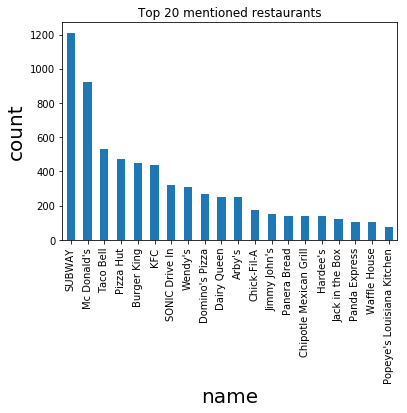

In [16]:
# top 20 restaurants recorded by count total
print("Number of unique restaurant:", df['name'].nunique())
nameplot = df['name'].value_counts()[:20].plot.bar(title='Top 20 mentioned restaurants')
nameplot.set_xlabel('name',size=20)
nameplot.set_ylabel('count',size=20)

Here we can see that now SUBWAY is number #1 and not McDonald's

In [17]:
# take a peek at the dateAdded column
df['dateAdded'].head()

0    2019-05-19T23:58:05Z
1    2018-01-18T18:30:23Z
2    2019-05-19T23:45:04Z
3    2019-05-19T23:26:58Z
4    2019-05-19T23:24:38Z
Name: dateAdded, dtype: object

In [18]:
# let's parse the dates for dateAdded and dateUpdated
from datetime import datetime
from dateutil.parser import parse

In [19]:
# let's convert dateAdded and dateUpdated column data to 
# datetime object with apply function
df['dateAdded'] = df['dateAdded'].apply(
        lambda x: datetime.strptime(x, '%Y-%m-%dT%H:%M:%SZ'))
df['dateUpdated'] = df['dateUpdated'].apply(
        lambda x: datetime.strptime(x, '%Y-%m-%dT%H:%M:%SZ'))

In [20]:
# check the top 6 rows again to verify the datatype has changed
print(df['dateAdded'].head())
print()
print(df['dateUpdated'].head())

0   2019-05-19 23:58:05
1   2018-01-18 18:30:23
2   2019-05-19 23:45:04
3   2019-05-19 23:26:58
4   2019-05-19 23:24:38
Name: dateAdded, dtype: datetime64[ns]

0   2019-05-19 23:58:05
1   2019-05-19 23:45:05
2   2019-05-19 23:45:04
3   2019-05-19 23:26:58
4   2019-05-19 23:24:38
Name: dateUpdated, dtype: datetime64[ns]


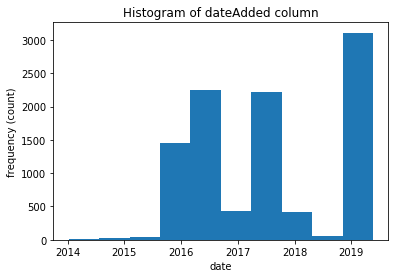

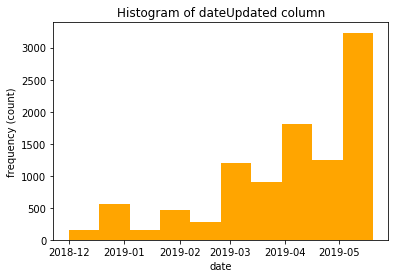

In [21]:
# histogram of dateAdded column
plt.hist(df['dateAdded'])
plt.xlabel("date")
plt.ylabel("frequency (count)")
plt.title("Histogram of dateAdded column")
plt.show()

# histogram of dateUpdated column
plt.hist(df['dateUpdated'], color="orange")
plt.xlabel("date")
plt.ylabel("frequency (count)")
plt.title("Histogram of dateUpdated column")
plt.show()

In [22]:
# drop primaryCategory column
df = df.drop(['primaryCategories'], axis=1)

# shape of dataset
print("Dimension after dropping columns:")
print(df.shape)

# take a peek at the head to verify the drop is successful
df.head()

Dimension after dropping columns:
(10000, 12)


,dateAdded,dateUpdated,address,categories,city,country,latitude,longitude,name,postalCode,province,names
0,2019-05-19 23:58:05,2019-05-19 23:58:05,2555 11th Avenue,"Fast Food Restaurants,Hamburgers and Hot Dogs,...",Greeley,US,40.39629,-104.69699,Carl's Jr,80631,CO,Carl's Jr
1,2018-01-18 18:30:23,2019-05-19 23:45:05,2513 Highway 6 And 50,"Restaurant,Mexican Restaurants,Fast Food Resta...",Grand Junction,US,39.08135,-108.58689,Del Taco,81505,CO,Del Taco
2,2019-05-19 23:45:04,2019-05-19 23:45:04,1125 Patterson Road,"Sandwich Shops,Fast Food Restaurants,Restauran...",Grand Junction,US,39.09148,-108.55411,Which Wich,81506,CO,Which Wich
3,2019-05-19 23:26:58,2019-05-19 23:26:58,3455 N Salida Court,"Fast Food Restaurants,Mexican Restaurants,Rest...",Aurora,US,39.76369,-104.77671,Chipotle Mexican Grill,80011,CO,Chipotle Mexican Grill
4,2019-05-19 23:24:38,2019-05-19 23:24:38,5225 E Colfax Avenue,"Fast Food Restaurants,Mexican Restaurants,Rest...",Denver,US,39.74044,-104.92636,Taco Bell,80220,CO,Taco Bell


In [23]:
# let's split the categories string data by ","
categories = df['categories'].values
for i in range(len(categories)):
    categories[i] = categories[i].split(",")

In [24]:
# update the "categories" column in the fastfood_data
df['categories'] = categories
df.head()

,dateAdded,dateUpdated,address,categories,city,country,latitude,longitude,name,postalCode,province,names
0,2019-05-19 23:58:05,2019-05-19 23:58:05,2555 11th Avenue,"[Fast Food Restaurants, Hamburgers and Hot Dog...",Greeley,US,40.39629,-104.69699,Carl's Jr,80631,CO,Carl's Jr
1,2018-01-18 18:30:23,2019-05-19 23:45:05,2513 Highway 6 And 50,"[Restaurant, Mexican Restaurants, Fast Food Re...",Grand Junction,US,39.08135,-108.58689,Del Taco,81505,CO,Del Taco
2,2019-05-19 23:45:04,2019-05-19 23:45:04,1125 Patterson Road,"[Sandwich Shops, Fast Food Restaurants, Restau...",Grand Junction,US,39.09148,-108.55411,Which Wich,81506,CO,Which Wich
3,2019-05-19 23:26:58,2019-05-19 23:26:58,3455 N Salida Court,"[Fast Food Restaurants, Mexican Restaurants, R...",Aurora,US,39.76369,-104.77671,Chipotle Mexican Grill,80011,CO,Chipotle Mexican Grill
4,2019-05-19 23:24:38,2019-05-19 23:24:38,5225 E Colfax Avenue,"[Fast Food Restaurants, Mexican Restaurants, R...",Denver,US,39.74044,-104.92636,Taco Bell,80220,CO,Taco Bell


In [25]:
# top 50 most appeared restaurants in the dataset and their corresponding category
top50_name_by_number = df['name'].value_counts()[:50].index.tolist()
top50_rest_categories = []
for name in top50_name_by_number:
    category = df[df.name == name]["categories"][:1].values[0]
    top50_rest_categories.append(category)

In [26]:
# remove stopword "Restaurants", "Restaurant", and "Fast Food Restaurants" in categories
stopwords = ["Fast Food Restaurants","Fast Food restaurants", "Fast Food", "Restaurants", "Restaurant", "restaurants", "restaurant"]
for i in range(len(top50_rest_categories)):
    for j in range(len(top50_rest_categories[i])):
        word = top50_rest_categories[i][j]
        # remove stopword as the only word given
        for stopword in stopwords:
            isRemoved = False
            if isRemoved == False and word == stopword:
                top50_rest_categories[i][j] = top50_rest_categories[i][j].replace(stopword, "")
                isRemoved = True

        # replace the stopword within a group of words
        for stopword in stopwords:
            if isRemoved == False and stopword in word:
                top50_rest_categories[i][j] = top50_rest_categories[i][j].replace(stopword, "")

In [27]:
top50_rest_categories

[['Delis And Delicatessens',
  '',
  'Carry-out food',
  'Caterers',
  'Delicatessens',
  'American ',
  'Take Out ',
  '',
  'Sandwiches',
  'Catering',
  '',
  'Sandwich Shops'],
 ['', 'Hamburgers and Hot Dogs', '', 'Take Out '],
 ['', 'Mexican ', ''],
 ['Pizza',
  'Carry-out food',
  'Caterers',
  ' delivery service',
  'American ',
  'Take Out ',
  '',
  'Home delivery beer and beverages',
  'Family Style ',
  'Catering',
  ''],
 ['Burger Joint',
  '',
  '  and Burger Joint Pleasant Valley',
  'Hot dog ',
  ' ',
  'Hamburger ',
  '  and Burger Joint',
  'Fast food ',
  ''],
 ['Carry-out food',
  'Caterers',
  'Barbecued poultry',
  'American ',
  '',
  'Take Out ',
  'Barbecue',
  'Chicken ',
  'Spare rib ',
  'Catering',
  ''],
 ['Carry Out Food',
  'American ',
  'Hot Dog Stands and ',
  'Take Out ',
  '',
  'Hamburgers and Hot Dogs',
  ''],
 ['Carry Out Food', '', '', 'Hamburgers and Hot Dogs', ''],
 ['Pizza', '', 'Food Delivery', 'Take Out ', '', 'Pizza Place', ''],
 ['Carry Ou

Number of unique cities: 2810


Text(0, 0.5, 'count')

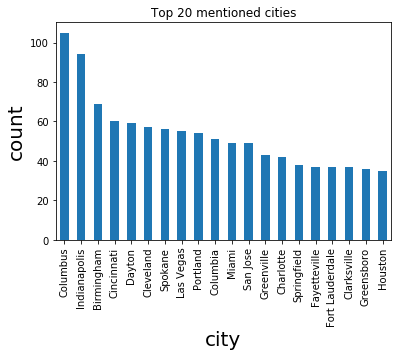

In [28]:
# top 20 fast food populated cities recorded by count total
print("Number of unique cities:", df['city'].nunique())
nameplot = df['city'].value_counts()[:20].plot.bar(title='Top 20 mentioned cities')
nameplot.set_xlabel('city',size=20)
nameplot.set_ylabel('count',size=20)

In [29]:
# let's run pandas' .descirbe() function 
rest_count_by_city = df['city'].value_counts()
rest_count_by_city.describe()

count    2810.000000
mean        3.558719
std         6.260422
min         1.000000
25%         1.000000
50%         2.000000
75%         3.000000
max       105.000000
Name: city, dtype: float64

In [30]:
print(len(rest_count_by_city[rest_count_by_city < 4]), "cities opened less than 4 fast food restaurants")
print("They are", round(100*len(rest_count_by_city[rest_count_by_city < 4])/len(rest_count_by_city),2), "%"),
print("of the total cities recorded in the dataset")

2121 cities opened less than 4 fast food restaurants
They are 75.48 %
of the total cities recorded in the dataset


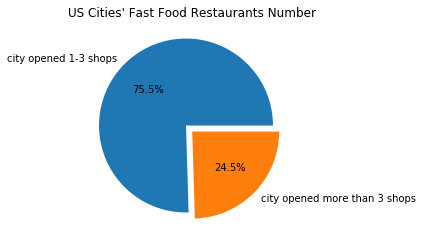

In [31]:
# plot pie chart
fig, ax = plt.subplots()
total_cities_with_less_than_4_rests = len(rest_count_by_city[rest_count_by_city < 4])
total_cities_with_greater_equal_4_rests = df['city'].nunique() - total_cities_with_less_than_4_rests
values = [total_cities_with_less_than_4_rests, total_cities_with_greater_equal_4_rests]
ax.pie(values, 
       labels=["city opened 1-3 shops", "city opened more than 3 shops"], autopct='%.1f%%', radius=1, 
       explode = (0.1, 0))
ax.set_aspect('equal')
ax.set_title("US Cities' Fast Food Restaurants Number")
plt.show()

In [32]:
us_state_names = pd.read_csv('C:/Users/shahk/OneDrive/Desktop/Dataset/datasets_269496_560051_US-2-letter-state-code.csv')
us_state_names.head()

,state_name,state_code
0,Alabama,AL
1,Alaska,AK
2,American Samoa,AS
3,Arizona,AZ
4,Arkansas,AR


In [33]:
def convert_state_names(state_code):
    return us_state_names[us_state_names['state_code']== state_code].values[0][0]

# use the above function to convert code to name
df['province_full'] = ""
state_names = [None] * len(df['province'].values)
state_codes = df['province'].values
for i in range(len(state_codes)):
    state_names[i] = convert_state_names(state_codes[i])
print(state_names[:20])

# # let's replace the province column values with full state names
df['province_full'] = state_names

['Colorado', 'Colorado', 'Colorado', 'Colorado', 'Colorado', 'Colorado', 'Colorado', 'Arkansas', 'Colorado', 'Colorado', 'Colorado', 'Colorado', 'Colorado', 'Colorado', 'Arkansas', 'Arkansas', 'Alaska', 'Alaska', 'Alaska', 'Alaska']


In [34]:
df['province_full'].value_counts()

Ohio                    922
Florida                 739
California              727
North Carolina          663
Alabama                 635
Indiana                 519
Texas                   426
Washington              404
Virginia                348
Oregon                  334
South Carolina          322
Illinois                305
Missouri                244
Tennessee               243
Georgia                 238
Michigan                210
Pennsylvania            194
Arizona                 186
New York                173
Louisiana               161
Colorado                154
West Virginia           154
Oklahoma                147
Kentucky                142
Arkansas                124
Maryland                114
Wisconsin               112
Iowa                    107
Mississippi              99
Nevada                   96
Kansas                   92
Hawaii                   91
Minnesota                83
Utah                     74
Nebraska                 74
New Mexico          

Number of unique provinces: 47


Text(0, 0.5, 'count')

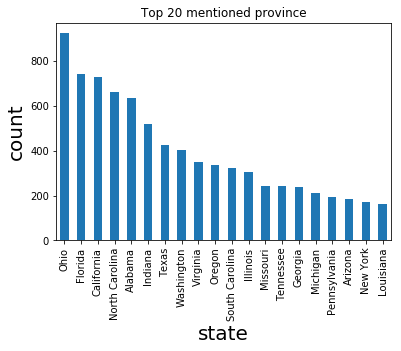

In [35]:
# top 20 fast food populated states recorded by count total
print("Number of unique provinces:", df['province_full'].nunique())
nameplot = df['province_full'].value_counts()[:20].plot.bar(title='Top 20 mentioned province')
nameplot.set_xlabel('state',size=20) # changed the label to state; it's the US
nameplot.set_ylabel('count',size=20)

In [36]:
df['province_full'].value_counts().describe()

count     47.000000
mean     212.765957
std      220.791877
min        1.000000
25%       71.500000
50%      142.000000
75%      274.500000
max      922.000000
Name: province_full, dtype: float64

In [37]:
df['province_full'].value_counts()[df['province_full'].value_counts() == 1]

Connecticut    1
Name: province_full, dtype: int64

From above descriptions, 

the stats show that the average number of fast food restaurants opened in different US states is 212.
Among 47 recorded states, OH(Ohio) has the maximum number of fast food restaurants opened. In Ohio, there are 922 fast food restaurants opened. 

CT(Connecticut) has only 1 fast food restaurant opened

In [38]:
# get top 3 fast food populated cities
top3_fastfood_populated_cities = df['city'].value_counts()[:3].index.tolist()
top3_fastfood_populated_cities[:3]

['Columbus', 'Indianapolis', 'Birmingham']

In [39]:
# take a look at the restaurant numbers
df[df["city"]=="Columbus"]["names"].value_counts()

SUBWAY                               21
Mc Donald's                           9
Pizza Hut                             6
Chipotle Mexican Grill                6
Dairy Queen                           3
Panera Bread                          3
Church's Chicken                      3
Domino's Pizza                        3
Wg Grinders                           2
Moe's Southwest Grill                 2
Panda Express                         2
Wendy's                               2
Arby's                                2
Bob Evans                             2
Waffle House                          2
Marino's Seafood                      1
H C Way Asian Bistro                  1
Tim Hortons                           1
Acropolis Gyro Palace                 1
Dunkin Donuts                         1
Hunan House                           1
SUSHI EN                              1
Jersey Mike's Subs                    1
Golden Phoenix Restaurant             1
Dan's Drive In                        1


In [40]:
# get the restaurant number count by unique restaurant name
def get_restaurants_counts(city_name):
    return df[df["city"]==city_name]["names"].value_counts()

# print the restaurants that opened more than 1 shop
def print_more_than_1_shop_rest(restaurants, city_name):
    more_than_1_shops = restaurants[restaurants > 1]
    print("\nAmong", len(restaurants), "unique fastfood restaurant brands in", city_name+",")
    print(len(more_than_1_shops), "brands opened more than 1 shops.")
    print("They occupied", str(round(len(more_than_1_shops)/sum(restaurants)*100,2))+
          "% of total restaurants by number")
    print(more_than_1_shops)

In [41]:
# let's generate a quick summary of the shops
for city in top3_fastfood_populated_cities:
    print_more_than_1_shop_rest(get_restaurants_counts(city), city)


Among 52 unique fastfood restaurant brands in Columbus,
15 brands opened more than 1 shops.
They occupied 14.29% of total restaurants by number
SUBWAY                    21
Mc Donald's                9
Pizza Hut                  6
Chipotle Mexican Grill     6
Dairy Queen                3
Panera Bread               3
Church's Chicken           3
Domino's Pizza             3
Wg Grinders                2
Moe's Southwest Grill      2
Panda Express              2
Wendy's                    2
Arby's                     2
Bob Evans                  2
Waffle House               2
Name: names, dtype: int64

Among 47 unique fastfood restaurant brands in Indianapolis,
21 brands opened more than 1 shops.
They occupied 22.34% of total restaurants by number
Pizza Hut                    8
Dairy Queen                  6
SUBWAY                       6
Jimmy John's                 5
STEAK 'N SHAKE               4
Church's Chicken             4
Domino's Pizza               3
Mc Donald's                 

In [42]:
# reusable function to create data needed for plotting pie chart
def create_pie_chart_data(city_name):
    counts =  df[df["city"]==city_name]["names"].value_counts()[:10].values
    labels = df[df["city"]==city_name]["names"].value_counts().index.tolist()[:10]
    return counts, labels

In [43]:
# reusable function to plot pie chart for our EDA
def plot_pie_chart(counts, labels, city_name):
    fig, ax = plt.subplots()
    ax.pie(counts, labels=labels, autopct='%.1f%%', radius=1.1, 
          explode = (0.1, 0, 0, 0, 0, 0, 0, 0, 0, 0))
    ax.set_aspect('equal')
    ax.set_title("Top 10 Restaurants in " + city_name)
    plt.show()

['SUBWAY', "Mc Donald's", 'Pizza Hut'] are the top 3 populated restaurants in Columbus


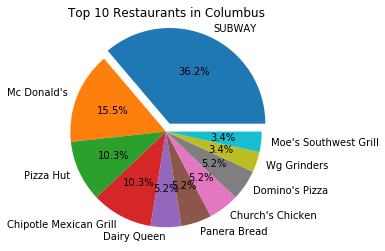

['Pizza Hut', 'Dairy Queen', 'SUBWAY'] are the top 3 populated restaurants in Indianapolis


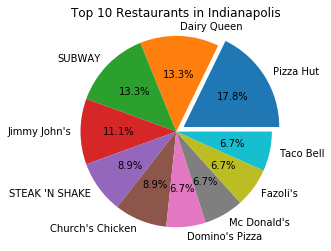

['SUBWAY', 'Chick-Fil-A', "Church's Chicken"] are the top 3 populated restaurants in Birmingham


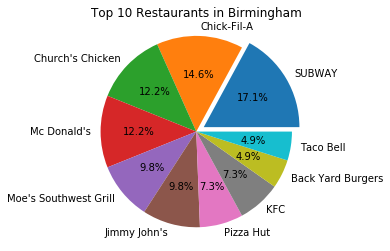

In [44]:
# for each city, let's create the data needed and plot them in pie chart
for city in top3_fastfood_populated_cities:
    counts, labels = create_pie_chart_data(city)
    print(labels[:3], "are the top 3 populated restaurants in", city)
    plot_pie_chart(counts, labels, city)

In [45]:
# create data needed
state_codes = df['province'].value_counts().index.tolist()
value_counts_by_states = df['province'].value_counts()

# plotly choropleth
data= [dict(type='choropleth',
            locations = state_codes, # Spatial coordinates
            z = value_counts_by_states, # Data to be color-coded
            locationmode = 'USA-states', # set of locations match entries in `locations`
            colorscale = 'Reds',
            marker_line_color = 'white',
            colorbar_title = "Number of Fast Fast Restaurants"
        )]
layout = dict(title = '2019 US Fast Food Restaurants by State', 
              geo = dict(scope='usa'))
iplot(dict(data=data, layout=layout))

From above choropleth, the interactive visualization shows Ohio(OH), Florida(FL), California(CA), and North Carolina(NC) have the darker red, which indicated there are more restaurants opened in those states than the others.

In [46]:
data = [dict(type = 'scattergeo',
            locationmode = 'USA-states',
            lon = df['longitude'],
            lat = df['latitude'],
            mode = 'markers',
            marker = dict(size = 3,
                opacity = 0.7,
                reversescale = True,
                autocolorscale = False,
                symbol = 'circle',
                line = dict(width=.5, color='black'),
                color = 'red'
            )
        )]

layout = dict(title = '2019 US Fast Food Restaurants by GPS location',
            geo = dict(scope='usa',
                showland = True,
                landcolor = "rgb(250, 250, 250)",
                subunitcolor = "rgb(217, 217, 217)"
            )
        )
iplot(dict(data=data, layout=layout ))

In [47]:
# input census data with "|" as separator
us_census_data = pd.read_csv('C:/Users/shahk/OneDrive/Desktop/Dataset/Population.txt', sep="|", names=["state", "population"])
us_census_data.head()

,state,population
0,California,"39,536,653"
1,Texas,"28,304,596"
2,Florida,"20,984,400"
3,New York,"19,849,399"
4,Pennsylvania,"12,805,537"


In [48]:
# let's divide the population by people in each state
per_capita_count = [None] * len(state_codes)
for i in range(len(state_codes)):
    state = df[df['province']==state_codes[i]]['province_full'][:1]
    per_capita_count[i] = value_counts_by_states[i] / int(us_census_data[us_census_data['state']=="California"].iloc[0,1].replace(",",""))
per_capita_count[:10]

[2.3320132839772755e-05,
 1.8691516451835214e-05,
 1.8388000623117996e-05,
 1.676924953662618e-05,
 1.606104593628601e-05,
 1.3127059592019587e-05,
 1.0774811919461165e-05,
 1.0218366233479601e-05,
 8.801959032799261e-06,
 8.447857232629176e-06]

In [49]:
# plotly choropleth
data= [dict(type='choropleth',
            locations = state_codes, # Spatial coordinates
            z = per_capita_count, # Data to be color-coded
            locationmode = 'USA-states', # set of locations match entries in `locations`
            colorscale = 'Reds',
            marker_line_color = 'white',
            colorbar_title = "Restaurants opened / population"
        )]
layout = dict(title = 'Ratio between number of fast food Restaurants and population', 
              geo = dict(scope='usa'))
iplot(dict(data=data, layout=layout))

From the above visualization, the output is consistent with the restaurant per state choropleth. This shows the restaurants are opened based on the populations in each state. That makes sense because restaurants need customers to visit their shops

In [50]:
address = 'USA'

geolocator = Nominatim(user_agent="US_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of USA are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of USA are 39.7837304, -100.4458825.


In [54]:
latitude = location.latitude
longitude = location.longitude

map_USA = folium.Map(location=[latitude, longitude], zoom_start=4)

# add markers to map
for lat, lng, name, city in zip(df['latitude'], df['longitude'], df['name'], df['city']):
    label = '{}, {}'.format(city, name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_USA)  
    
map_USA

In [51]:
CLIENT_ID = 'Use Your' # your Foursquare ID
CLIENT_SECRET = 'Use Your' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: C3JHGKPS0SGQCCUU43DJN4I3RPR1DYKUM23NDVSN202RN303
CLIENT_SECRET:PWJTDCHPEL5THEVPCUVLS3JTBEWU4FFBT5BFYEMCN4KOMDNP


### LA, California

In [52]:
CA_data = df[df['province'] == "CA"].reset_index(drop=True)

In [53]:
CA_data.head()

,dateAdded,dateUpdated,address,categories,city,country,latitude,longitude,name,postalCode,province,names,province_full
0,2016-05-05 12:40:33,2019-05-18 23:45:36,3121 Yosemite Blvd,"[Asian Restaurants, Caterers, Chinese Restaura...",Modesto,US,37.6386,-120.9367,Fat Wong Chinese Food To Go,95354,CA,Fat Wong Chinese Food To Go,California
1,2016-06-08 16:17:17,2019-05-18 21:25:22,8256 Orion Ave,"[Mexican Restaurant, Restaurant, Mexican Resta...",Van Nuys,US,34.2208,-118.4719,Taco Bell,91406,CA,Taco Bell,California
2,2019-03-21 11:03:37,2019-05-18 17:50:19,990 N. Western Ave.,"[Mexican, Breakfast, Vegetarian, Fast Food, Re...",Los Angeles,US,34.0883,-118.3088,Taco Bell,90029,CA,Taco Bell,California
3,2017-06-22 19:45:38,2019-05-18 15:27:00,1140 Hamner Avenue,"[Mexican Restaurant, Restaurant, Mexican, Brea...",Norco,US,33.8993,-117.5631,Taco Bell,92860,CA,Taco Bell,California
4,2016-03-30 04:13:48,2019-05-18 14:04:15,1066 Harriman Pl,"[Mexican Restaurant, Carry-out food, Restauran...",San Bernardino,US,34.0670,-117.2617,El Pollo Loco,92408,CA,El Pollo Loco,California


In [54]:
address = 'California, USA'

geolocator = Nominatim(user_agent="CA_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Ca, USA are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Ca, USA are 36.7014631, -118.7559974.


In [55]:
latitude = location.latitude
longitude = location.longitude

map_CA = folium.Map(location=[latitude, longitude], zoom_start = 6)

# add markers to map
for lat, lng, name, city in zip(CA_data['latitude'], CA_data['longitude'], CA_data['name'], CA_data['city']):
    label = '{}, {}'.format(city, name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_CA)  
    
map_CA

In [56]:
LA_data = df[(df['city'] == "Los Angeles")].reset_index(drop=True)

In [57]:
LA_data.head()

,dateAdded,dateUpdated,address,categories,city,country,latitude,longitude,name,postalCode,province,names,province_full
0,2019-03-21 11:03:37,2019-05-18 17:50:19,990 N. Western Ave.,"[Mexican, Breakfast, Vegetarian, Fast Food, Re...",Los Angeles,US,34.088300,-118.308800,Taco Bell,90029,CA,Taco Bell,California
1,2016-03-27 05:32:19,2019-05-17 22:47:36,3005 W 6th St,"[Restaurant, Burger Joint, Mexican, American, ...",Los Angeles,US,34.063900,-118.287500,Carl's Jr,90020,CA,Carl's Jr,California
2,2015-10-23 04:11:11,2019-05-15 13:10:51,4376 W Sunset Blvd,"[Restaurant, Mexican Restaurants, Taco Place, ...",Los Angeles,US,34.092500,-118.280500,Del Taco,90029,CA,Del Taco,California
3,2019-03-06 07:10:04,2019-05-15 09:51:07,2801 West Olympic Boulevard,"[Fast Food, Chicken, Restaurants]",Los Angeles,US,34.052900,-118.295200,KFC,90006,CA,KFC,California
4,2015-10-23 03:52:15,2019-05-01 12:28:03,255 S Grand Ave,"[Restaurant, Fast Food Restaurant, wich Place,...",Los Angeles,US,34.053538,-118.250897,SUBWAY,90012,CA,SUBWAY,California


In [58]:
address = 'Los Angeles, California, USA'

geolocator = Nominatim(user_agent="LA_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of LA, CA, USA are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of LA, CA, USA are 34.0536909, -118.2427666.


In [59]:
latitude = location.latitude
longitude = location.longitude

map_LA = folium.Map(location=[latitude, longitude], zoom_start = 10)

# add markers to map
for lat, lng, name, add in zip(LA_data['latitude'], LA_data['longitude'], LA_data['name'], LA_data['address']):
    label = '{}, {}'.format(city, name)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_LA)  
    
map_LA

In [60]:
LIMIT = 100 # limit of number of venues returned by Foursquare API

radius = 2500 # define radius

 # create URL
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    lat, 
    lng, 
    radius, 
    LIMIT)
url

'https://api.foursquare.com/v2/venues/explore?&client_id=C3JHGKPS0SGQCCUU43DJN4I3RPR1DYKUM23NDVSN202RN303&client_secret=PWJTDCHPEL5THEVPCUVLS3JTBEWU4FFBT5BFYEMCN4KOMDNP&v=20180605&ll=34.0404,-118.19067&radius=2500&limit=100'

In [61]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5f3483ec99578521cc64a451'},
 'response': {'suggestedFilters': {'header': 'Tap to show:',
   'filters': [{'name': '$-$$$$', 'key': 'price'},
    {'name': 'Open now', 'key': 'openNow'}]},
  'headerLocation': 'Current map view',
  'headerFullLocation': 'Current map view',
  'headerLocationGranularity': 'unknown',
  'totalResults': 119,
  'suggestedBounds': {'ne': {'lat': 34.062900022500024,
    'lng': -118.16356784572615},
   'sw': {'lat': 34.01789997749997, 'lng': -118.21777215427385}},
  'groups': [{'type': 'Recommended Places',
    'name': 'recommended',
    'items': [{'reasons': {'count': 0,
       'items': [{'summary': 'This spot is popular',
         'type': 'general',
         'reasonName': 'globalInteractionReason'}]},
      'venue': {'id': '4be9b71eb3352d7faa5154d2',
       'name': 'Los Cinco Puntos',
       'location': {'address': '3300 E Cesar E Chavez Ave',
        'lat': 34.04001656392321,
        'lng': -118.19281032728183,
        'label

In [62]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

In [63]:
venues = results['response']['groups'][0]['items']
    
nearby_venues = json_normalize(venues) # flatten JSON

# filter columns
filtered_columns = ['venue.name', 'venue.categories', 'venue.location.lat', 'venue.location.lng']
nearby_venues =nearby_venues.loc[:, filtered_columns]

# filter the category for each row
nearby_venues['venue.categories'] = nearby_venues.apply(get_category_type, axis=1)

# clean columns
nearby_venues.columns = [col.split(".")[-1] for col in nearby_venues.columns]

nearby_venues.head(15)

,name,categories,lat,lng
0,Los Cinco Puntos,Mexican Restaurant,34.040017,-118.192810
1,El Mercadito Mariachi Restaurant,Mexican Restaurant,34.037077,-118.193952
2,Thai Daily B.B.Q.,Thai Restaurant,34.040331,-118.187514
3,El Mercado De Los Angeles,Shopping Mall,34.037096,-118.193838
4,Manuel's Original El Tepeyac Cafe,Mexican Restaurant,34.047779,-118.197665
5,El Mercadito del Este,Mexican Restaurant,34.037482,-118.193779
6,CVS pharmacy,Pharmacy,34.040920,-118.186530
7,Starbucks,Coffee Shop,34.033609,-118.184325
8,Chalio Birrieria,Mexican Restaurant,34.035825,-118.189680
9,7-Eleven,Convenience Store,34.036370,-118.191564


In [64]:
print('{} venues were returned by Foursquare.'.format(nearby_venues.shape[0]))

100 venues were returned by Foursquare.


In [65]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Address', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [66]:
LA_venues = getNearbyVenues(names=LA_data['address'],
                                   latitudes=LA_data['latitude'],
                                   longitudes=LA_data['longitude']
                                  )

990 N. Western Ave.
3005 W 6th St
4376 W Sunset Blvd
2801 West Olympic Boulevard
255 S Grand Ave
7149 Beverly Boulevard
1000 E Washington Blvd
11047 Santa Monica Blvd
1657 W 3rd St
10800 W. Pico Blvd.
505 S Flower St
454 W Florence Ave
11205 National Blvd
4351 S Central Ave
3101 N San Fernando Rd
9149 S Sepulveda Blvd
4430 York Blvd
4720 Crenshaw Boulevard
4700 W Pico Boulevard
3464 E Cesar E Chavez Ave


In [67]:
print(LA_venues.shape)
LA_venues.head()

(617, 7)


,Address,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,990 N. Western Ave.,34.0883,-118.3088,Catalina's Market,34.089990,-118.309014,Market
1,990 N. Western Ave.,34.0883,-118.3088,Tlayuda L.A. Mexican Restaurant,34.090600,-118.307939,Mexican Restaurant
2,990 N. Western Ave.,34.0883,-118.3088,Chick-fil-A,34.089125,-118.309499,Fast Food Restaurant
3,990 N. Western Ave.,34.0883,-118.3088,Wingstop,34.090357,-118.309574,Wings Joint
4,990 N. Western Ave.,34.0883,-118.3088,Dave’s Hot Chicken,34.088027,-118.308968,Fried Chicken Joint


In [68]:
LA_venues.groupby('Address').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Address,,,,,,
1000 E Washington Blvd,13,13,13,13,13,13
10800 W. Pico Blvd.,57,57,57,57,57,57
11047 Santa Monica Blvd,35,35,35,35,35,35
11205 National Blvd,35,35,35,35,35,35
1657 W 3rd St,6,6,6,6,6,6
255 S Grand Ave,62,62,62,62,62,62
2801 West Olympic Boulevard,31,31,31,31,31,31
3005 W 6th St,45,45,45,45,45,45
3101 N San Fernando Rd,18,18,18,18,18,18


In [69]:
# one hot encoding
LA_onehot = pd.get_dummies(LA_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
LA_onehot['Address'] = LA_venues['Address'] 

# move neighborhood column to the first column
fixed_columns = [LA_onehot.columns[-1]] + list(LA_onehot.columns[:-1])
LA_onehot = LA_onehot[fixed_columns]

LA_onehot.head()

,Address,ATM,Accessories Store,Adult Boutique,American Restaurant,Antique Shop,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Auto Garage,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Big Box Store,Board Shop,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Building,Burger Joint,Burrito Place,Bus Station,Café,Cheese Shop,Chinese Restaurant,Clothing Store,Cocktail Bar,Coffee Shop,Comic Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Donut Shop,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Flower Shop,Food,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hardware Store,Hobby Shop,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jazz Club,Juice Bar,Karaoke Bar,Kids Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Library,Light Rail Station,Lingerie Store,Liquor Store,Lounge,Marijuana Dispensary,Market,Medical School,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Movie Theater,Multiplex,Music Store,Music Venue,Neighborhood,New American Restaurant,North Indian Restaurant,Opera House,Optical Shop,Outdoor Supply Store,Paper / Office Supplies Store,Park,Performing Arts Venue,Perfume Shop,Pet Store,Pharmacy,Pizza Place,Playground,Plaza,Poke Place,Pool,Print Shop,Ramen Restaurant,Rental Car Location,Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,School,Seafood Restaurant,Shipping Store,Shoe Store,Shop & Service,Shopping Mall,Smoke Shop,Smoothie Shop,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sports Bar,Steakhouse,Supermarket,Supplement Shop,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Thai Restaurant,Theater,Thrift / Vintage Store,Toy / Game Store,Train Station,Tunnel,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Wings Joint,Yoga Studio
0,990 N. Western Ave.,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,990 N. Western Ave.,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,990 N. Western Ave.,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,990 N. Western Ave.,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,990 N. Western Ave.,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [70]:
LA_grouped = LA_onehot.groupby('Address').mean().reset_index()
LA_grouped

,Address,ATM,Accessories Store,Adult Boutique,American Restaurant,Antique Shop,Art Museum,Arts & Crafts Store,Asian Restaurant,Astrologer,Auto Garage,Automotive Shop,BBQ Joint,Bagel Shop,Bakery,Bank,Bar,Baseball Field,Big Box Store,Board Shop,Bookstore,Boutique,Bowling Alley,Breakfast Spot,Brewery,Building,Burger Joint,Burrito Place,Bus Station,Café,Cheese Shop,Chinese Restaurant,Clothing Store,Cocktail Bar,Coffee Shop,Comic Shop,Concert Hall,Convenience Store,Cosmetics Shop,Creperie,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Design Studio,Dessert Shop,Diner,Discount Store,Dive Bar,Donut Shop,Farmers Market,Fast Food Restaurant,Filipino Restaurant,Flower Shop,Food,Food Court,Food Truck,French Restaurant,Fried Chicken Joint,Frozen Yogurt Shop,Furniture / Home Store,Garden Center,Gas Station,Gastropub,Gay Bar,General Entertainment,German Restaurant,Gift Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hardware Store,Hobby Shop,Hotel,Hotel Bar,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indie Theater,Intersection,Italian Restaurant,Japanese Restaurant,Jazz Club,Juice Bar,Karaoke Bar,Kids Store,Korean Restaurant,Kosher Restaurant,Latin American Restaurant,Library,Light Rail Station,Lingerie Store,Liquor Store,Lounge,Marijuana Dispensary,Market,Medical School,Mediterranean Restaurant,Men's Store,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Mobile Phone Shop,Movie Theater,Multiplex,Music Store,Music Venue,Neighborhood,New American Restaurant,North Indian Restaurant,Opera House,Optical Shop,Outdoor Supply Store,Paper / Office Supplies Store,Park,Performing Arts Venue,Perfume Shop,Pet Store,Pharmacy,Pizza Place,Playground,Plaza,Poke Place,Pool,Print Shop,Ramen Restaurant,Rental Car Location,Restaurant,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,School,Seafood Restaurant,Shipping Store,Shoe Store,Shop & Service,Shopping Mall,Smoke Shop,Smoothie Shop,South American Restaurant,Southern / Soul Food Restaurant,Spa,Spanish Restaurant,Speakeasy,Sports Bar,Steakhouse,Supermarket,Supplement Shop,Sushi Restaurant,Szechuan Restaurant,Taco Place,Taiwanese Restaurant,Thai Restaurant,Theater,Thrift / Vintage Store,Toy / Game Store,Train Station,Tunnel,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Wings Joint,Yoga Studio
0,1000 E Washington Blvd,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.076923,0.076923,0.000000,0.076923,0.000000,0.000000,0.076923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.153846,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.076923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.076923,0.000000,0.076923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.153846,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.076923,0.000000,0.000000,0.000000,0.000000,0.000000,0.076923,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,10800 W. Pico Blvd.,0.017544,0.017544,0.000000,0.017544,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.017544,0.000000,0.035088

In [71]:
num_top_venues = 5

for hood in LA_grouped['Address']:
    print("----"+hood+"----")
    temp = LA_grouped[LA_grouped['Address'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----1000 E Washington Blvd----
                venue  freq
0         Gas Station  0.15
1  Mexican Restaurant  0.15
2         Coffee Shop  0.08
3          Print Shop  0.08
4  Light Rail Station  0.08


----10800 W. Pico Blvd.----
                 venue  freq
0       Clothing Store  0.09
1  Japanese Restaurant  0.07
2       Sandwich Place  0.05
3   Italian Restaurant  0.05
4       Lingerie Store  0.04


----11047 Santa Monica Blvd----
                  venue  freq
0          Liquor Store  0.06
1           Pizza Place  0.06
2      Sushi Restaurant  0.06
3  Fast Food Restaurant  0.06
4           Coffee Shop  0.06


----11205 National Blvd----
                  venue  freq
0           Coffee Shop  0.09
1    Chinese Restaurant  0.06
2            Food Truck  0.06
3           Video Store  0.06
4  Fast Food Restaurant  0.06


----1657 W 3rd St----
                       venue  freq
0                 Poke Place  0.17
1             Cosmetics Shop  0.17
2  Middle Eastern Restaurant  0.17
3        

In [72]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [73]:
num_top_venues = 3

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Address']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Address'] = LA_grouped['Address']

for ind in np.arange(LA_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(LA_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Address,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue
0,1000 E Washington Blvd,Gas Station,Mexican Restaurant,Grocery Store
1,10800 W. Pico Blvd.,Clothing Store,Japanese Restaurant,Sandwich Place
2,11047 Santa Monica Blvd,Pizza Place,Liquor Store,Sandwich Place
3,11205 National Blvd,Coffee Shop,Food Truck,Video Store
4,1657 W 3rd St,Poke Place,Cosmetics Shop,Liquor Store


In [74]:
# set number of clusters
kclusters = 5

LA_grouped_clustering = LA_grouped.drop('Address', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(LA_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

array([3, 1, 1, 1, 4, 1, 2, 1, 1, 1])

In [75]:
# add clustering labels
neighborhoods_venues_sorted['Cluster Labels'] = kmeans.labels_

LA_merged = LA_venues.copy()
# LA_merged[0, "Cluster Labels"] = kmeans.labels_
# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
LA_merged = LA_merged.join(neighborhoods_venues_sorted.set_index('Address'), on='Address')

# LA_merged.head() # check the last columns!

In [76]:
LA_merged.head()

,Address,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Cluster Labels
0,990 N. Western Ave.,34.0883,-118.3088,Catalina's Market,34.089990,-118.309014,Market,Fast Food Restaurant,Grocery Store,Donut Shop,1
1,990 N. Western Ave.,34.0883,-118.3088,Tlayuda L.A. Mexican Restaurant,34.090600,-118.307939,Mexican Restaurant,Fast Food Restaurant,Grocery Store,Donut Shop,1
2,990 N. Western Ave.,34.0883,-118.3088,Chick-fil-A,34.089125,-118.309499,Fast Food Restaurant,Fast Food Restaurant,Grocery Store,Donut Shop,1
3,990 N. Western Ave.,34.0883,-118.3088,Wingstop,34.090357,-118.309574,Wings Joint,Fast Food Restaurant,Grocery Store,Donut Shop,1
4,990 N. Western Ave.,34.0883,-118.3088,Dave’s Hot Chicken,34.088027,-118.308968,Fried Chicken Joint,Fast Food Restaurant,Grocery Store,Donut Shop,1


In [83]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(LA_merged['Venue Latitude'], LA_merged['Venue Longitude'], LA_merged['Address'], LA_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

In [78]:
LA_merged.loc[LA_merged['Cluster Labels'] == 0]
 
#, LA_merged.columns[[1] + list(range(5, LA_merged.shape[1]))]]

,Address,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Cluster Labels
429,454 W Florence Ave,33.974417,-118.282092,Tom's Jr. Burgers Express,33.974439,-118.286893,Burger Joint,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
430,454 W Florence Ave,33.974417,-118.282092,SUBWAY,33.974385,-118.282363,Sandwich Place,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
431,454 W Florence Ave,33.974417,-118.282092,Little Caesars Pizza,33.974385,-118.282363,Pizza Place,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
432,454 W Florence Ave,33.974417,-118.282092,Pizza Hut,33.973828,-118.282904,Pizza Place,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
433,454 W Florence Ave,33.974417,-118.282092,Jack in the Box,33.974899,-118.278070,Fast Food Restaurant,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
434,454 W Florence Ave,33.974417,-118.282092,Shell,33.974941,-118.278692,Gas Station,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
435,454 W Florence Ave,33.974417,-118.282092,McDonald's,33.974900,-118.283005,Fast Food Restaurant,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
436,454 W Florence Ave,33.974417,-118.282092,Burger King,33.974266,-118.282955,Fast Food Restaurant,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
437,454 W Florence Ave,33.974417,-118.282092,Garage Door Springs Repair,33.976517,-118.282778,Auto Garage,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0
438,454 W Florence Ave,33.974417,-118.282092,Chinatown Express,33.974396,-118.278793,Chinese Restaurant,Fast Food Restaurant,Pizza Place,Chinese Restaurant,0


In [79]:
LA_merged.loc[LA_merged['Cluster Labels'] == 1, LA_merged.columns[[1] + list(range(5, LA_merged.shape[1]))]]

,Neighborhood Latitude,Venue Longitude,Venue Category,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Cluster Labels
0,34.088300,-118.309014,Market,Fast Food Restaurant,Grocery Store,Donut Shop,1
1,34.088300,-118.307939,Mexican Restaurant,Fast Food Restaurant,Grocery Store,Donut Shop,1
2,34.088300,-118.309499,Fast Food Restaurant,Fast Food Restaurant,Grocery Store,Donut Shop,1
3,34.088300,-118.309574,Wings Joint,Fast Food Restaurant,Grocery Store,Donut Shop,1
4,34.088300,-118.308968,Fried Chicken Joint,Fast Food Restaurant,Grocery Store,Donut Shop,1
5,34.088300,-118.308670,Korean Restaurant,Fast Food Restaurant,Grocery Store,Donut Shop,1
6,34.088300,-118.307995,Theater,Fast Food Restaurant,Grocery Store,Donut Shop,1
7,34.088300,-118.307822,Coffee Shop,Fast Food Restaurant,Grocery Store,Donut Shop,1
8,34.088300,-118.309262,Food Truck,Fast Food Restaurant,Grocery Store,Donut Shop,1
9,34.088300,-118.309316,Medical School,Fast Food Restaurant,Grocery Store,Donut Shop,1


In [80]:
LA_merged.loc[LA_merged['Cluster Labels'] == 2]
#, LA_merged.columns[[1] + list(range(5, LA_merged.shape[1]))]]

,Address,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Cluster Labels
115,2801 West Olympic Boulevard,34.0529,-118.2952,Jeon Ju,34.052544,-118.292384,Korean Restaurant,Korean Restaurant,Coffee Shop,Hotel,2
116,2801 West Olympic Boulevard,34.0529,-118.2952,Beverly Soon Tofu,34.052982,-118.292499,Korean Restaurant,Korean Restaurant,Coffee Shop,Hotel,2
117,2801 West Olympic Boulevard,34.0529,-118.2952,Surawon Restaurant,34.052843,-118.295490,Korean Restaurant,Korean Restaurant,Coffee Shop,Hotel,2
118,2801 West Olympic Boulevard,34.0529,-118.2952,Park's BBQ,34.053920,-118.291902,Korean Restaurant,Korean Restaurant,Coffee Shop,Hotel,2
119,2801 West Olympic Boulevard,34.0529,-118.2952,World 8,34.051034,-118.291768,Video Game Store,Korean Restaurant,Coffee Shop,Hotel,2
120,2801 West Olympic Boulevard,34.0529,-118.2952,Aventura Hotel,34.052047,-118.297720,Hotel,Korean Restaurant,Coffee Shop,Hotel,2
121,2801 West Olympic Boulevard,34.0529,-118.2952,A-won Japanese Restaurant,34.055390,-118.292037,Japanese Restaurant,Korean Restaurant,Coffee Shop,Hotel,2
122,2801 West Olympic Boulevard,34.0529,-118.2952,Ong Ga Nae Korean B.B.Q,34.054748,-118.291439,Korean Restaurant,Korean Restaurant,Coffee Shop,Hotel,2
123,2801 West Olympic Boulevard,34.0529,-118.2952,I Love Boba (Vermont & Olympic),34.052075,-118.291625,Coffee Shop,Korean Restaurant,Coffee Shop,Hotel,2
124,2801 West Olympic Boulevard,34.0529,-118.2952,Wako Donkasu,34.052539,-118.297724,Asian Restaurant,Korean Restaurant,Coffee Shop,Hotel,2


In [81]:
LA_merged.loc[LA_merged['Cluster Labels'] == 3, LA_merged.columns[[1] + list(range(5, LA_merged.shape[1]))]]

,Neighborhood Latitude,Venue Longitude,Venue Category,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Cluster Labels
263,34.025188,-118.251844,Print Shop,Gas Station,Mexican Restaurant,Grocery Store,3
264,34.025188,-118.252492,Sandwich Place,Gas Station,Mexican Restaurant,Grocery Store,3
265,34.025188,-118.249983,Convenience Store,Gas Station,Mexican Restaurant,Grocery Store,3
266,34.025188,-118.250811,Clothing Store,Gas Station,Mexican Restaurant,Grocery Store,3
267,34.025188,-118.252166,Grocery Store,Gas Station,Mexican Restaurant,Grocery Store,3
268,34.025188,-118.249942,Gas Station,Gas Station,Mexican Restaurant,Grocery Store,3
269,34.025188,-118.250641,Coffee Shop,Gas Station,Mexican Restaurant,Grocery Store,3
270,34.025188,-118.248962,Gas Station,Gas Station,Mexican Restaurant,Grocery Store,3
271,34.025188,-118.249800,Mexican Restaurant,Gas Station,Mexican Restaurant,Grocery Store,3
272,34.025188,-118.251602,Chinese Restaurant,Gas Station,Mexican Restaurant,Grocery Store,3


In [82]:
LA_merged.loc[LA_merged['Cluster Labels'] == 4, LA_merged.columns[[1] + list(range(5, LA_merged.shape[1]))]]

,Neighborhood Latitude,Venue Longitude,Venue Category,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,Cluster Labels
311,34.188015,-118.229316,Thai Restaurant,Poke Place,Cosmetics Shop,Liquor Store,4
312,34.188015,-118.227064,Park,Poke Place,Cosmetics Shop,Liquor Store,4
313,34.188015,-118.225854,Cosmetics Shop,Poke Place,Cosmetics Shop,Liquor Store,4
314,34.188015,-118.225454,Middle Eastern Restaurant,Poke Place,Cosmetics Shop,Liquor Store,4
315,34.188015,-118.226967,Liquor Store,Poke Place,Cosmetics Shop,Liquor Store,4
316,34.188015,-118.229080,Poke Place,Poke Place,Cosmetics Shop,Liquor Store,4
